# FourClass Pipeline Modeling

**List of Models**
*   SENet 154
*   InceptionResNetV2
*   MobileNet
*   EfficientNetb4
*   DenseNet

## Imports

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Data Manipulation and Visualization Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Image Processing Libraries
from PIL import Image
import cv2
import os
import tarfile

# Data Augmentation
import imgaug.augmenters as iaa

In [ ]:
# Import pretrained models
%%capture
!pip install pretrainedmodels
import pretrainedmodels
from pretrainedmodels import se_resnext50_32x4d

%%capture
!pip install git+https://github.com/qubvel/classification_models.git
from classification_models.tfkeras import Classifiers

In [ ]:
# SSL Configuration
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

In [ ]:
# TensorFlow and Keras for Model Building
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import VGG16, MobileNet, DenseNet121, DenseNet169, DenseNet201, NASNetMobile, InceptionV3
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, Adadelta, RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Model, Sequential, load_model
from tensorflow.keras.layers import  Concatenate, GlobalMaxPooling2D, GlobalAveragePooling2D, Dense, Dropout, Input, Add, Activation, ZeroPadding2D, AveragePooling2D, Conv2D, Flatten, MaxPooling2D, BatchNormalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras import mixed_precision

In [ ]:
# Set global policy for mixed precision
mixed_precision.set_global_policy('mixed_float16')

In [ ]:
# Scikit-learn for Model Evaluation
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, precision_score, recall_score, f1_score, auc, roc_curve, roc_auc_score

In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import ResNet101

from tensorflow.keras.metrics import Recall
from tensorflow.keras.regularizers import l2
from tensorflow.keras.optimizers.schedules import PiecewiseConstantDecay
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import LearningRateScheduler
from tensorflow.keras.optimizers import RMSprop

In [ ]:
%%capture
!pip install git+https://github.com/qubvel/classification_models.git

In [ ]:
from classification_models.tfkeras import Classifiers

In [ ]:
# Register the custom expand_dims function
@tf.keras.utils.register_keras_serializable()
def expand_dims(x, channels_axis):
    if channels_axis == 3:
        return x[:, None, None, :]
    elif channels_axis == 1:
        x = layers.Lambda(expand_dims, arguments={'channels_axis': channels_axis})(x)

In [ ]:
# Define slice_tensor function
def slice_tensor(x, start, stop, axis):
    if axis == 3:
        return x[:, :, :, start:stop]
    elif axis == 1:
        return x[:, start:stop, :, :]
    else:
        raise ValueError("Slice axis should be in (1, 3), got {}.".format(axis))

## FourClass Model (masked, denoised, balanced data)

### Copying training, validation, test data to disk

In [ ]:
# Copy the training_augmented directory
!cp -r /content/drive/MyDrive/MIDS\ 210A\ -\ Capstone\ Project/Code/Datasets/four_class_maskeddenoised_data/training_augmented /content/

# Copy the validation directory
!cp -r /content/drive/MyDrive/MIDS\ 210A\ -\ Capstone\ Project/Code/Datasets/four_class_maskeddenoised_data/validation /content/

# Copy the test directory
!cp -r /content/drive/MyDrive/MIDS\ 210A\ -\ Capstone\ Project/Code/Datasets/four_class_maskeddenoised_data/test /content/

In [ ]:
# Renamed the directory
train_dir = '/content/training_augmented'
validation_dir = '/content/validation'
test_dir = '/content/test'

### Normalizing images (height, width, channels)

In [ ]:
# Custom normalization function
def normalize_image(image):
    max_pixel_value = np.max(image)  # Get the max pixel value in the image
    if max_pixel_value > 0:  # Avoid division by zero
        image = image / max_pixel_value  # Normalize the image
    return image

In [ ]:
# Modify ImageDataGenerator to use the custom preprocessing function
train_datagen = ImageDataGenerator(preprocessing_function=normalize_image)
validation_datagen = ImageDataGenerator(preprocessing_function=normalize_image)
test_datagen = ImageDataGenerator(preprocessing_function=normalize_image)

### Creating generators for each dataset

In [ ]:
# Load training data from the directory
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=64,
    class_mode='categorical'
)

# Load validation data from the directory
validation_generator = validation_datagen.flow_from_directory(
    validation_dir,
    target_size=(224, 224),
    batch_size=64,
    class_mode='categorical'
)

# Load test data from the directory
test_generator = test_datagen.flow_from_directory(    test_dir,
    target_size=(224, 224),
    batch_size=64,
    class_mode='categorical',
    shuffle=False
)

Found 24104 images belonging to 4 classes.
Found 3013 images belonging to 4 classes.
Found 3013 images belonging to 4 classes.


In [ ]:
# Convert ImageDataGenerator output to tf.data.Dataset with batch size in shape
def generator_to_tf_dataset(generator):
    return tf.data.Dataset.from_generator(
        lambda: generator,
        output_signature=(
            tf.TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32),  # Include batch dimension (None)
            tf.TensorSpec(shape=(None, 4), dtype=tf.float32)  # Include batch dimension for labels
        )
    )

# Wrap the train, validation, and test generators
train_ds = generator_to_tf_dataset(train_generator)
val_ds = generator_to_tf_dataset(validation_generator)
test_ds = generator_to_tf_dataset(test_generator)

# Prefetch for performance
train_ds = train_ds.prefetch(tf.data.experimental.AUTOTUNE)
val_ds = val_ds.prefetch(tf.data.experimental.AUTOTUNE)
test_ds = test_ds.prefetch(tf.data.experimental.AUTOTUNE)

In [ ]:
# Define total training and validation samples and batch size
total_train_samples = 24104  # train dataset size
total_val_samples = 3013     # validation dataset size
total_test_samples = 3013    # test dataset size
batch_size = 64

steps_per_epoch = total_train_samples // batch_size
validation_steps = total_val_samples // batch_size

# Calculate the steps for the test dataset
test_steps = total_test_samples // batch_size

## SENet 154

unforzen layers = last 20

### Model Architecture

In [ ]:
# Reset the session before model compilation
tf.keras.backend.clear_session()

In [ ]:
# Load SENet143 with ImageNet weights
SENet154, preprocess_input = Classifiers.get('senet154')
senet_base = SENet154(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

# Freeze all layers in the base model initially
for layer in senet_base.layers:
    layer.trainable = False

# Add custom layers on top of SENet
x = senet_base.output
x = GlobalAveragePooling2D()(x)  # Reduce dimensions
x = BatchNormalization()(x)  # Batch Normalization before fully connected layer
x = Dense(256, activation='relu')(x)  # Fully connected layer
x = Dropout(0.3)(x)  # Dropout to avoid overfitting

# Output layer for 4 classes (adjust if needed)
predictions = Dense(4, activation='softmax')(x)

# Create the complete model
model_senet154 = Model(inputs=senet_base.input, outputs=predictions)

# Compile the model
model_senet154.compile(optimizer=RMSprop(learning_rate=0.00005),
                       loss='categorical_crossentropy',
                       metrics=['accuracy'])

# Early stopping and reducing learning rate callbacks
early_stopping = EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', factor=0.1, patience=10, verbose=1)

### Model Training

In [ ]:
# Train the model with all layers frozen except the new top layers
history = model_senet154.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=10,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 342s 407ms/step - accuracy: 0.4310 - loss: 1.4450 - val_accuracy: 0.6479 - val_loss: 0.8842 - learning_rate: 5.0000e-05
Epoch 2/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 175s 310ms/step - accuracy: 0.5376 - loss: 1.1351 - val_accuracy: 0.6599 - val_loss: 0.8566 - learning_rate: 5.0000e-05
Epoch 3/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 81s 216ms/step - accuracy: 0.5669 - loss: 1.0540 - val_accuracy: 0.6636 - val_loss: 0.8275 - learning_rate: 5.0000e-05
Epoch 4/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 79s 211ms/step - accuracy: 0.5813 - loss: 0.9965 - val_accuracy: 0.6775 - val_loss: 0.8102 - learning_rate: 5.0000e-05
Epoch 5/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 81s 217ms/step - accuracy: 0.6054 - loss: 0.9567 - val_accuracy: 0.6823 - val_loss: 0.7955 - learning_rate: 5.0000e-05
Epoch 6/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 78s 207ms/step - accuracy: 0.6249 - loss: 0.9012 - val_accuracy: 0.6785 - val_loss: 0.7915 - learning_rate: 5.0000e-05
Epoch 7/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 78s 

In [ ]:
# Phase 2: Unfreeze the last set of layers for fine-tuning
for layer in senet_base.layers[-20:]:  # Adjust the number of layers to unfreeze as needed
    layer.trainable = True

# Recompile the model with a lower learning rate
model_senet154.compile(optimizer=RMSprop(learning_rate=0.00001),
                       loss='categorical_crossentropy',
                       metrics=['accuracy'])

# Continue training with fine-tuning
fine_tune_history = model_senet154.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=40,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 433s 652ms/step - accuracy: 0.6043 - loss: 0.9570 - val_accuracy: 0.6829 - val_loss: 0.8064 - learning_rate: 1.0000e-05
Epoch 2/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 84s 224ms/step - accuracy: 0.6281 - loss: 0.9002 - val_accuracy: 0.6911 - val_loss: 0.8022 - learning_rate: 1.0000e-05
Epoch 3/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 79s 209ms/step - accuracy: 0.6465 - loss: 0.8543 - val_accuracy: 0.6806 - val_loss: 0.7845 - learning_rate: 1.0000e-05
Epoch 4/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 79s 212ms/step - accuracy: 0.6684 - loss: 0.8063 - val_accuracy: 0.7070 - val_loss: 0.7670 - learning_rate: 1.0000e-05
Epoch 5/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 218ms/step - accuracy: 0.6821 - loss: 0.7771 - val_accuracy: 0.6758 - val_loss: 0.8052 - learning_rate: 1.0000e-05
Epoch 6/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 79s 211ms/step - accuracy: 0.7061 - loss: 0.7330 - val_accuracy: 0.6982 - val_loss: 0.7740 - learning_rate: 1.0000e-05
Epoch 7/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 79s 2

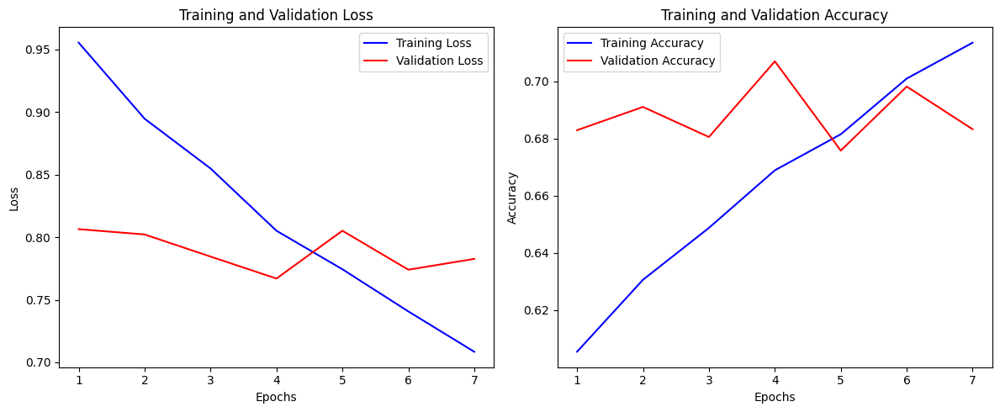

In [ ]:
# Assuming 'history' is the returned object from model_mobilenet.fit
history_dict = fine_tune_history.history

# Extract loss and accuracy for both training and validation
train_loss = history_dict['loss']
val_loss = history_dict['val_loss']
train_accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']

# Create a figure with two subplots: one for loss and one for accuracy
epochs = range(1, len(train_loss) + 1)

plt.figure(figsize=(12, 5))

# Plot the loss values
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot the accuracy values
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Evaluate the model on the test data
test_loss, test_acc = model_senet154.evaluate(test_generator)
print(f"Test Accuracy: {test_acc * 100:.2f}%")

/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


48/48 ━━━━━━━━━━━━━━━━━━━━ 9s 184ms/step - accuracy: 0.6061 - loss: 0.9745
Test Accuracy: 69.76%


### Saving Model

In [ ]:
# Define the path where you want to save your model in Google Drive
save_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass'

# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Save your senet154_v3 model in .h5 format
model_senet154.save(os.path.join(save_path, "senet154_v1.h5"))

# Optionally create a tar.gz archive for portability
with tarfile.open(os.path.join(save_path, "senet154_v1.tar.gz"), mode="w:gz") as archive:
    archive.add(os.path.join(save_path, "senet154_v1.h5"), arcname="senet154_v1.h5")

print(f"Model saved to: {save_path}")

Model saved to: /content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass


### Loading Model

In [ ]:
# Define the path to your saved SENet154_v3 model
model_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass/senet154_v1.h5'

# Load the senet154_v3 model
model = tf.keras.models.load_model(model_path, custom_objects={'slice_tensor': slice_tensor, 'expand_dims': expand_dims})

# Display the model summary to verify it loaded correctl
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input (InputLayer)        │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d            │ (None, 226, 226, 3)    │              0 │ input[0][0]            │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 112, 112, 64)   │          1,728 │ zero_padding2d[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 112, 112, 64)   │            256 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 112, 112, 64)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_1          │ (None, 114, 114, 64)   │              0 │ activation[0][0]       │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 112, 112, 64)   │         36,864 │ zero_padding2d_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 112, 112, 64)   │            256 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 112, 112, 64)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_2          │ (None, 114, 114, 64)   │              0 │ activation_1[0][0]     │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 112, 112, 128)  │         73,728 │ zero_padding2d_2[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 112, 112, 128)  │            512 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 112, 112, 128)  │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_3          │ (None, 114, 114, 128)  │              0 │ activation_2[0][0]     │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 56, 56, 128)    │              0 │ zero_padding2d_3[0][0] │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)    

 Total params: 113,821,302 (434.19 MB)

 Trainable params: 5,286,276 (20.17 MB)

 Non-trainable params: 108,535,024 (414.03 MB)

 Optimizer params: 2 (12.00 B)

### Evaluating Model

#### Printing Metrics

In [ ]:
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)  # Get the predicted class indices
y_true = test_generator.classes  # True labels from the generator

48/48 ━━━━━━━━━━━━━━━━━━━━ 147s 2s/step


In [ ]:
print(f"Precision: {precision_score(y_true, y_pred, average='weighted')}")
print(f"Recall: {recall_score(y_true, y_pred, average='weighted')}")
print(f"F1 Score: {f1_score(y_true, y_pred, average='weighted')}")
print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
# print(f"AUC: {roc_auc_score(y_true, y_pred)}")

Precision: 0.7294886973255101
Recall: 0.6976435446398938
F1 Score: 0.7066705604397142
Accuracy: 0.6976435446398938


#### Displaying Confusion Matrix

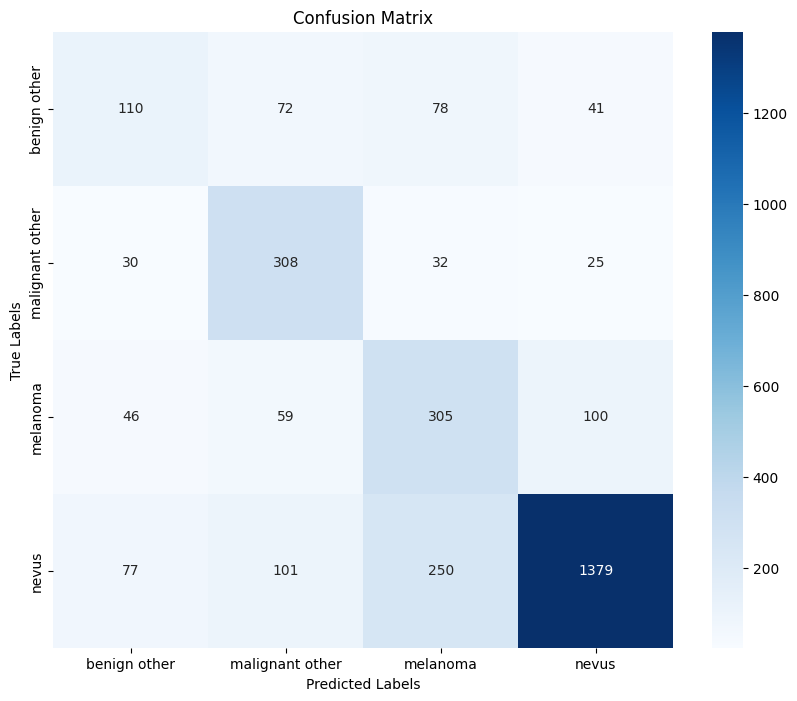

In [ ]:
# Get the class names from the test generator (adjust this based on your test generator)
class_names = list(test_generator.class_indices.keys())

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

## SENet 154 v2

### Model Architecture

In [ ]:
# Reset the session before model compilation
tf.keras.backend.clear_session()

In [ ]:
# Load SENet154 with ImageNet weights
SENet154, preprocess_input = Classifiers.get('senet154')
senet_base = SENet154(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

# Freeze all layers in the base model initially
for layer in senet_base.layers:
    layer.trainable = False

# Add custom layers on top of SENet
x = senet_base.output

# Combine Global Average and Max Pooling for richer features
x_avg = GlobalAveragePooling2D()(x)
x_max = GlobalMaxPooling2D()(x)
x = Concatenate()([x_avg, x_max])

x = BatchNormalization()(x)  # Batch Normalization for stability
x = Dense(256, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)  # Fully connected layer with L2 regularization
x = Dropout(0.4)(x)  # Increased dropout rate to 0.4 to help prevent overfitting
x = Dense(128, activation='relu')(x)  # Additional dense layer for increased complexity
x = BatchNormalization()(x)  # Batch Normalization after the new dense layer
x = Dropout(0.4)(x)  # Additional dropout layer

# Output layer for 4 classes
predictions = Dense(4, activation='softmax')(x)

# Create the complete model
senet_v2 = Model(inputs=senet_base.input, outputs=predictions)

# Compile the model with Adam optimizer and Categorical Cross-Entropy loss, using class weights
class_weights = {0: 1.0, 1: 1, 2: 1.1, 3: 1.0}  # Class weights based on class imbalance
senet_v2.compile(optimizer=Adam(learning_rate=5e-5),
                 loss='categorical_crossentropy',
                 metrics=['accuracy'])

# Early stopping and reducing learning rate callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-7, verbose=1)

### Model Training

In [ ]:
# Train the model with all layers frozen except the new top layers
history = senet_v2.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=5,
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/5
376/376 ━━━━━━━━━━━━━━━━━━━━ 433s 669ms/step - accuracy: 0.3847 - loss: 6.5844 - val_accuracy: 0.6351 - val_loss: 5.4617 - learning_rate: 5.0000e-05
Epoch 2/5
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 218ms/step - accuracy: 0.4821 - loss: 5.9264 - val_accuracy: 0.6351 - val_loss: 5.1434 - learning_rate: 5.0000e-05
Epoch 3/5
376/376 ━━━━━━━━━━━━━━━━━━━━ 83s 220ms/step - accuracy: 0.5111 - loss: 5.4907 - val_accuracy: 0.6463 - val_loss: 4.7908 - learning_rate: 5.0000e-05
Epoch 4/5
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 218ms/step - accuracy: 0.5256 - loss: 5.1001 - val_accuracy: 0.6538 - val_loss: 4.4554 - learning_rate: 5.0000e-05
Epoch 5/5
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 219ms/step - accuracy: 0.5334 - loss: 4.7515 - val_accuracy: 0.6497 - val_loss: 4.1530 - learning_rate: 5.0000e-05


In [ ]:
# Phase 2: Unfreeze more layers for fine-tuning
for layer in senet_base.layers[-30:]:  # Unfreezing the last 30 layers for more fine-tuning capacity
    layer.trainable = True

# Recompile the model with a lower learning rate for fine-tuning
senet_v2.compile(optimizer=Adam(learning_rate=1e-5),
                 loss='categorical_crossentropy',
                 metrics=['accuracy'])

# Continue training with fine-tuning
fine_tune_history = senet_v2.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=40,
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 447s 687ms/step - accuracy: 0.5464 - loss: 4.4665 - val_accuracy: 0.6528 - val_loss: 4.0784 - learning_rate: 1.0000e-05
Epoch 2/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 83s 221ms/step - accuracy: 0.5580 - loss: 4.3565 - val_accuracy: 0.6504 - val_loss: 4.0060 - learning_rate: 1.0000e-05
Epoch 3/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 219ms/step - accuracy: 0.5682 - loss: 4.2582 - val_accuracy: 0.6511 - val_loss: 3.9417 - learning_rate: 1.0000e-05
Epoch 4/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 83s 220ms/step - accuracy: 0.5750 - loss: 4.1583 - val_accuracy: 0.6690 - val_loss: 3.8327 - learning_rate: 1.0000e-05
Epoch 5/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 219ms/step - accuracy: 0.5879 - loss: 4.0583 - val_accuracy: 0.6660 - val_loss: 3.7955 - learning_rate: 1.0000e-05
Epoch 6/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 82s 219ms/step - accuracy: 0.5968 - loss: 3.9795 - val_accuracy: 0.6690 - val_loss: 3.7140 - learning_rate: 1.0000e-05
Epoch 7/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 92s 2

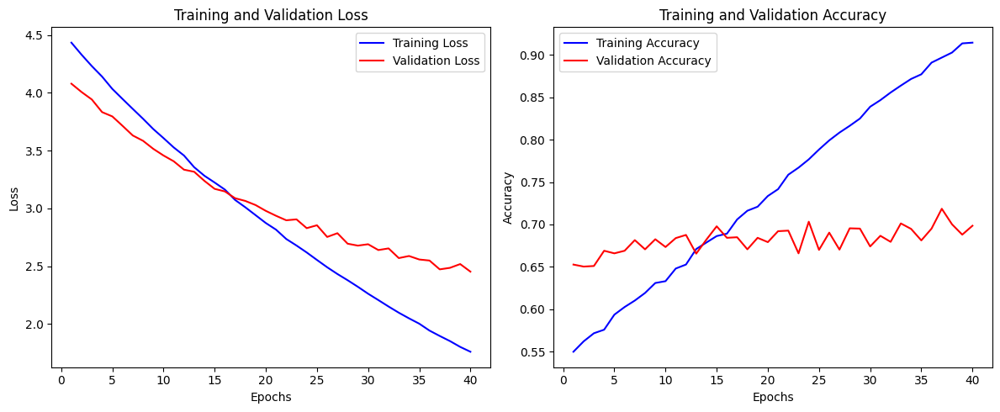

In [ ]:
# Assuming 'history' is the returned object from model_mobilenet.fit
history_dict = fine_tune_history.history

# Extract loss and accuracy for both training and validation
train_loss = history_dict['loss']
val_loss = history_dict['val_loss']
train_accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']

# Create a figure with two subplots: one for loss and one for accuracy
epochs = range(1, len(train_loss) + 1)

plt.figure(figsize=(12, 5))

# Plot the loss values
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot the accuracy values
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Evaluate the model on the test data
test_loss, test_acc = senet_v2.evaluate(test_generator)
print(f"Test Accuracy: {test_acc * 100:.2f}%")

48/48 ━━━━━━━━━━━━━━━━━━━━ 9s 192ms/step - accuracy: 0.6265 - loss: 2.7062
Test Accuracy: 70.26%


### Saving Model

In [ ]:
# Define the path where you want to save your model in Google Drive
save_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass'

# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Save your senet154_v3 model in .h5 format
senet_v2.save(os.path.join(save_path, "senet_v2.h5"))

# Optionally create a tar.gz archive for portability
with tarfile.open(os.path.join(save_path, "senet_v2.tar.gz"), mode="w:gz") as archive:
    archive.add(os.path.join(save_path, "senet_v2.h5"), arcname="senet_v2.h5")

print(f"Model saved to: {save_path}")

Model saved to: /content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass


### Loading Model

In [ ]:
# Define the path to your saved senet_v2 model
model_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass/senet_v2.h5'

# Load the senet_v2 model
model = tf.keras.models.load_model(model_path, custom_objects={'slice_tensor': slice_tensor, 'expand_dims': expand_dims})

# Display the model summary to verify it loaded correctly
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input (InputLayer)        │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d            │ (None, 226, 226, 3)    │              0 │ input[0][0]            │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 112, 112, 64)   │          1,728 │ zero_padding2d[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 112, 112, 64)   │            256 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 112, 112, 64)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_1          │ (None, 114, 114, 64)   │              0 │ activation[0][0]       │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 112, 112, 64)   │         36,864 │ zero_padding2d_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 112, 112, 64)   │            256 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 112, 112, 64)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_2          │ (None, 114, 114, 64)   │              0 │ activation_1[0][0]     │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 112, 112, 128)  │         73,728 │ zero_padding2d_2[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 112, 112, 128)  │            512 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 112, 112, 128)  │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_3          │ (None, 114, 114, 128)  │              0 │ activation_2[0][0]     │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 56, 56, 128)    │              0 │ zero_padding2d_3[0][0] │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)    

 Total params: 114,386,678 (436.35 MB)

 Trainable params: 5,893,380 (22.48 MB)

 Non-trainable params: 108,493,296 (413.87 MB)

 Optimizer params: 2 (12.00 B)

### Evaluating Model

#### Printing Metrics

In [ ]:
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)  # Get the predicted class indices
y_true = test_generator.classes  # True labels from the generator

48/48 ━━━━━━━━━━━━━━━━━━━━ 142s 2s/step


In [ ]:
print(f"Precision: {precision_score(y_true, y_pred, average='weighted')}")
print(f"Recall: {recall_score(y_true, y_pred, average='weighted')}")
print(f"F1 Score: {f1_score(y_true, y_pred, average='weighted')}")
print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
# print(f"AUC: {roc_auc_score(y_true, y_pred)}")

Precision: 0.7374773862187187
Recall: 0.7026219714570195
F1 Score: 0.7130303200540178
Accuracy: 0.7026219714570195


#### Displaying Confusion Matrix

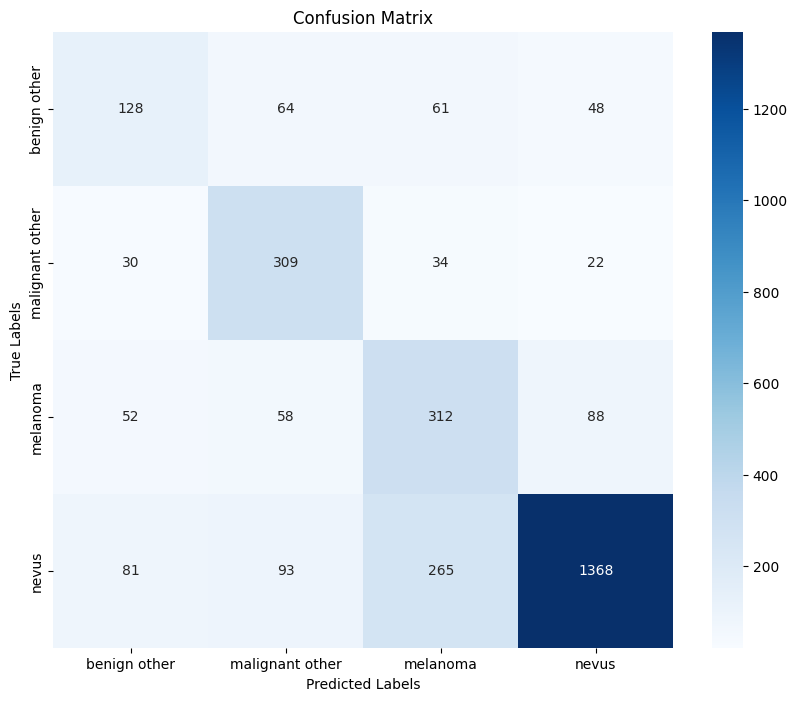

In [ ]:
# Get the class names from the test generator (adjust this based on your test generator)
class_names = list(test_generator.class_indices.keys())

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

## Inception Resnetv2 - Underifit

unforzen layers = last 20

### Model Architecture

In [ ]:
# Reset the session before model compilation
tf.keras.backend.clear_session()

In [ ]:
from tensorflow.keras.applications import InceptionResNetV2
inception_resnet_base = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze all layers in the base model initially
for layer in inception_resnet_base.layers:
    layer.trainable = False

# Add custom layers on top of InceptionResNetV2 with reduced complexity
x = inception_resnet_base.output

# Combine Global Average and Max Pooling for richer features
x_avg = GlobalAveragePooling2D()(x)
x_max = GlobalMaxPooling2D()(x)
x = Concatenate()([x_avg, x_max])

x = BatchNormalization()(x)  # Batch Normalization for stability
x = Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001))(x)  # Reduced dense layer size
x = Dropout(0.5)(x)  # Increased dropout rate to 0.5
x = Dense(64, activation='relu')(x)  # Further reduced dense layer size
x = BatchNormalization()(x)  # Batch Normalization after the new dense layer
x = Dropout(0.5)(x)  # Additional dropout layer with higher rate

# Output layer for 4 classes
predictions = Dense(4, activation='softmax')(x)

# Create the complete model
inception_resnet_v2_model = Model(inputs=inception_resnet_base.input, outputs=predictions)

# Compile the model with RMSprop optimizer and Categorical Cross-Entropy loss, using class weights
class_weights = {0: 1.0, 1: 1.0, 2: 1.1, 3: 1.0}  # Class weights based on class imbalance
inception_resnet_v2_model.compile(optimizer=RMSprop(learning_rate=5e-5),
                                  loss='categorical_crossentropy',
                                  metrics=['accuracy'])

# Early stopping and reducing learning rate callbacks with more aggressive early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-7, verbose=1)

### Model Training

In [ ]:
# Train the model with all layers frozen except the new top layers
history = inception_resnet_v2_model.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=8,
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 94s 175ms/step - accuracy: 0.3613 - loss: 2.2176 - val_accuracy: 0.5466 - val_loss: 1.2955 - learning_rate: 5.0000e-05
Epoch 2/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 108ms/step - accuracy: 0.4276 - loss: 1.8678 - val_accuracy: 0.5843 - val_loss: 1.2374 - learning_rate: 5.0000e-05
Epoch 3/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 39s 104ms/step - accuracy: 0.4481 - loss: 1.7581 - val_accuracy: 0.5897 - val_loss: 1.1928 - learning_rate: 5.0000e-05
Epoch 4/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 39s 103ms/step - accuracy: 0.4618 - loss: 1.6686 - val_accuracy: 0.5982 - val_loss: 1.1871 - learning_rate: 5.0000e-05
Epoch 5/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 38s 102ms/step - accuracy: 0.4783 - loss: 1.6023 - val_accuracy: 0.6111 - val_loss: 1.1702 - learning_rate: 5.0000e-05
Epoch 6/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 39s 104ms/step - accuracy: 0.4888 - loss: 1.5444 - val_accuracy: 0.6155 - val_loss: 1.1528 - learning_rate: 5.0000e-05
Epoch 7/8
376/376 ━━━━━━━━━━━━━━━━━━━━ 38s 102ms/ste

In [ ]:
# Phase 2: Unfreeze fewer layers for fine-tuning
for layer in inception_resnet_base.layers[-24:]:  # Unfreezing only the last 10 layers now
    layer.trainable = True

# Recompile the model with a lower learning rate for fine-tuning
inception_resnet_v2_model.compile(optimizer=RMSprop(learning_rate=1e-5),  # Lower learning rate for fine-tuning
                                  loss='categorical_crossentropy',
                                  metrics=['accuracy'])

# Continue training with fine-tuning
fine_tune_history = inception_resnet_v2_model.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=40,
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 102s 184ms/step - accuracy: 0.5044 - loss: 1.4946 - val_accuracy: 0.6134 - val_loss: 1.1258 - learning_rate: 1.0000e-05
Epoch 2/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 42s 111ms/step - accuracy: 0.5230 - loss: 1.4191 - val_accuracy: 0.6260 - val_loss: 1.0971 - learning_rate: 1.0000e-05
Epoch 3/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 40s 108ms/step - accuracy: 0.5308 - loss: 1.4047 - val_accuracy: 0.6324 - val_loss: 1.1011 - learning_rate: 1.0000e-05
Epoch 4/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.5347 - loss: 1.3750 - val_accuracy: 0.6365 - val_loss: 1.0828 - learning_rate: 1.0000e-05
Epoch 5/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.5439 - loss: 1.3606 - val_accuracy: 0.6612 - val_loss: 1.0520 - learning_rate: 1.0000e-05
Epoch 6/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 108ms/step - accuracy: 0.5579 - loss: 1.3255 - val_accuracy: 0.6399 - val_loss: 1.0841 - learning_rate: 1.0000e-05
Epoch 7/40
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 1

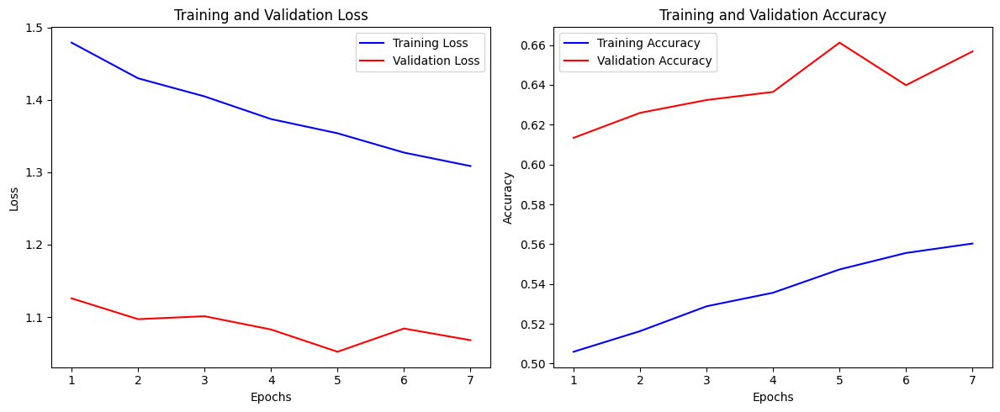

In [ ]:
# Assuming 'history' is the returned object from model_mobilenet.fit
history_dict = fine_tune_history.history

# Extract loss and accuracy for both training and validation
train_loss = history_dict['loss']
val_loss = history_dict['val_loss']
train_accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']

# Create a figure with two subplots: one for loss and one for accuracy
epochs = range(1, len(train_loss) + 1)

plt.figure(figsize=(12, 5))

# Plot the loss values
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot the accuracy values
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Evaluate the model on the test data
test_loss, test_acc = model_senet154.evaluate(test_generator)
print(f"Test Accuracy: {test_acc * 100:.2f}%")

48/48 ━━━━━━━━━━━━━━━━━━━━ 19s 177ms/step - accuracy: 0.6061 - loss: 0.9745
Test Accuracy: 69.76%


### Saving Model

In [ ]:
# Define the path where you want to save your model in Google Drive
save_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass'

# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Save your inception_resnet_v2_model in .keras format
model_save_path = os.path.join(save_path, "inception_resnet_v2_model.keras")
inception_resnet_v2_model.save(model_save_path)

print(f"Model saved to: {model_save_path}")

Model saved to: /content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass/inception_resnet_v2_model.keras


### Loading Model

In [ ]:
# Define the path to your saved InceptionResNetV2 model
model_path = model_save_path

# Load the model with custom objects
model = tf.keras.models.load_model(model_path)

# Display the model summary to verify it loaded correctly
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_406 (Conv2D)       │ (None, 111, 111, 32)   │            864 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_410   │ (None, 111, 111, 32)   │             96 │ conv2d_406[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_406            │ (None, 111, 111, 32)   │              0 │ batch_normalization_4… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_407 (Conv2D)       │ (None, 109, 109, 32)   │          9,216 │ activation_406[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_411   │ (None, 109, 109, 32)   │             96 │ conv2d_407[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_407            │ (None, 109, 109, 32)   │              0 │ batch_normalization_4… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_408 (Conv2D)       │ (None, 109, 109, 64)   │         18,432 │ activation_407[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_412   │ (None, 109, 109, 64)   │            192 │ conv2d_408[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_408            │ (None, 109, 109, 64)   │              0 │ batch_normalization_4… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_8           │ (None, 54, 54, 64)     │              0 │ activation_408[0][0]   │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_409 (Conv2D)       │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_413   │ (None, 54, 54, 80)     │            240 │ conv2d_409[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_409            │ (None, 54, 54, 80)     │              0 │ batch_normalization_4… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_410 (Conv2D)  

 Total params: 61,324,170 (233.93 MB)

 Trainable params: 6,573,028 (25.07 MB)

 Non-trainable params: 48,178,112 (183.78 MB)

 Optimizer params: 6,573,030 (25.07 MB)

### Evaluating Model

#### Printing Metrics

In [ ]:
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)  # Get the predicted class indices
y_true = test_generator.classes  # True labels from the generator

48/48 ━━━━━━━━━━━━━━━━━━━━ 27s 329ms/step


In [ ]:
print(f"Precision: {precision_score(y_true, y_pred, average='weighted')}")
print(f"Recall: {recall_score(y_true, y_pred, average='weighted')}")
print(f"F1 Score: {f1_score(y_true, y_pred, average='weighted')}")
print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
# print(f"AUC: {roc_auc_score(y_true, y_pred)}")

Precision: 0.7126089852115328
Recall: 0.6661135081314304
F1 Score: 0.680173003319568
Accuracy: 0.6661135081314304


#### Displaying Confusion Matrix

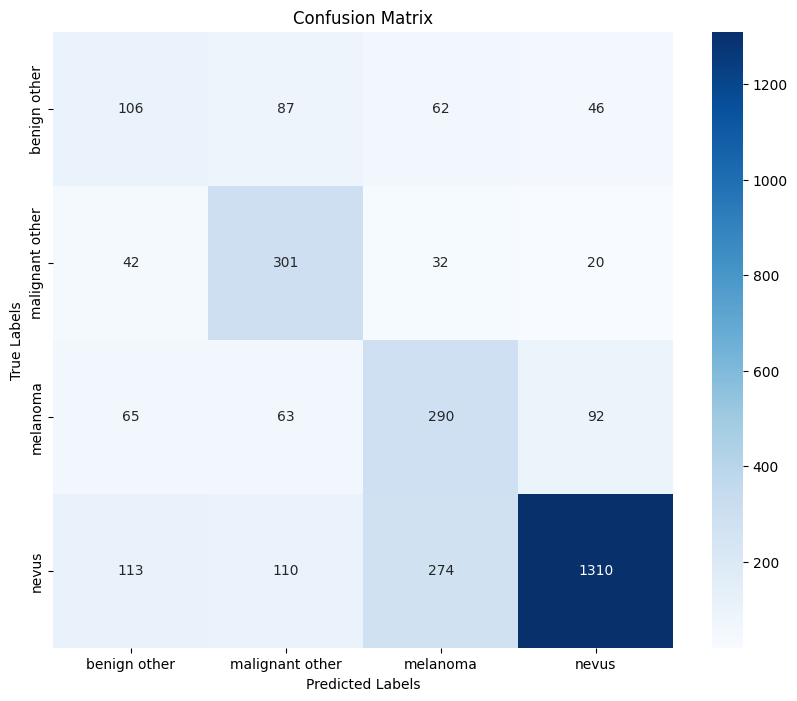

In [ ]:
# Get the class names from the test generator (adjust this based on your test generator)
class_names = list(test_generator.class_indices.keys())

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

## Inception Resnetv2

In [ ]:
from tensorflow.keras.metrics import Recall

### Model Architecture

In [ ]:
!pip install tensorflow-addons

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 11.4 MB/s eta 0:00:00
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.4.0
    Uninstalling typeguard-4.4.0:
      Successfully uninstalled typeguard-4.4.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
inflect 7.4.0 requires typeguard>=4.0.1, but you have typeguard 2.13.3 which is incompatible.


In [ ]:
!pip install keras-cv

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 650.7/650.7 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 43.0 MB/s eta 0:00:00


In [ ]:
# Reset the session before model compilation
tf.keras.backend.clear_session()

In [ ]:
import tensorflow as tf
from tensorflow.keras.metrics import Recall
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, Concatenate, BatchNormalization, Dense, Dropout, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from keras_cv.losses import FocalLoss

# Load InceptionResNetV2 with ImageNet weights
inception_resnet_base = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze all layers in the base model initially
for layer in inception_resnet_base.layers:
    layer.trainable = False

# Add custom layers on top of InceptionResNetV2
x = inception_resnet_base.output
x_avg = GlobalAveragePooling2D()(x)
x_max = GlobalMaxPooling2D()(x)
x = Concatenate()([x_avg, x_max])

# Flatten and add a single dense layer
x = Flatten()(x)
x = BatchNormalization()(x)  # Batch Normalization for stability
x = Dense(64, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.0001))(x)  # Reduced dense layer size
x = Dropout(0.3)(x)  # Lower dropout rate to prevent overfitting

# Output layer for 4 classes
predictions = Dense(4, activation='softmax')(x)

# Create the complete model
inception_resnet_v2_model = Model(inputs=inception_resnet_base.input, outputs=predictions)

# Define class weights
class_weights = {0: 1.0, 1: 1.2, 2: 1.3, 3: 1.0}  # Adjusted slightly to prioritize classes with lower recall

# Instantiate the FocalLoss
focal_loss = FocalLoss(alpha=0.25, gamma=2.0)

# Compile the model with the imported Focal Loss and Adam optimizer, tracking recall
inception_resnet_v2_model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss=focal_loss,
    metrics=['accuracy', Recall(name='recall')]
)

# Early stopping and reducing learning rate callbacks, monitoring 'val_recall'
early_stopping = EarlyStopping(monitor='val_recall', patience=3, restore_best_weights=True, mode='max')
reduce_lr = ReduceLROnPlateau(monitor='val_recall', factor=0.5, patience=3, min_lr=1e-7, verbose=1, mode='max')

### Model Training

In [ ]:
# Initial training phase with all layers frozen except the new top layers
history = inception_resnet_v2_model.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=10,
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 97s 180ms/step - accuracy: 0.3744 - loss: 0.4779 - recall: 0.2300 - val_accuracy: 0.5687 - val_loss: 0.1844 - val_recall: 0.2726 - learning_rate: 1.0000e-04
Epoch 2/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 110ms/step - accuracy: 0.4632 - loss: 0.2761 - recall: 0.2221 - val_accuracy: 0.6077 - val_loss: 0.1686 - val_recall: 0.2838 - learning_rate: 1.0000e-04
Epoch 3/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.4999 - loss: 0.2325 - recall: 0.1930 - val_accuracy: 0.6195 - val_loss: 0.1630 - val_recall: 0.2770 - learning_rate: 1.0000e-04
Epoch 4/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.5384 - loss: 0.2104 - recall: 0.1917 - val_accuracy: 0.5992 - val_loss: 0.1651 - val_recall: 0.2723 - learning_rate: 1.0000e-04
Epoch 5/10
376/376 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - accuracy: 0.5539 - loss: 0.2011 - recall: 0.1836
Epoch 5: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-05.
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s

In [ ]:
# Fine-tuning: Unfreeze only the last 10 layers for fine-tuning
for layer in inception_resnet_base.layers[-10:]:
    layer.trainable = True

# Recompile the model with a lower learning rate for fine-tuning
inception_resnet_v2_model.compile(
    optimizer=Adam(learning_rate=1e-5),
    loss=focal_loss,
    metrics=['accuracy', Recall(name='recall')]
)

# Continue training with fine-tuning
fine_tune_history = inception_resnet_v2_model.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_ds,
    validation_steps=validation_steps,
    epochs=20,  # Reduced to prevent overfitting
    class_weight=class_weights,
    callbacks=[reduce_lr, early_stopping]
)

Epoch 1/20
376/376 ━━━━━━━━━━━━━━━━━━━━ 100s 181ms/step - accuracy: 0.4623 - loss: 0.2541 - recall: 0.1742 - val_accuracy: 0.6026 - val_loss: 0.1691 - val_recall: 0.2597 - learning_rate: 1.0000e-05
Epoch 2/20
376/376 ━━━━━━━━━━━━━━━━━━━━ 42s 111ms/step - accuracy: 0.5210 - loss: 0.2198 - recall: 0.1977 - val_accuracy: 0.6202 - val_loss: 0.1630 - val_recall: 0.2930 - learning_rate: 1.0000e-05
Epoch 3/20
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.5525 - loss: 0.2056 - recall: 0.2095 - val_accuracy: 0.6107 - val_loss: 0.1622 - val_recall: 0.2889 - learning_rate: 1.0000e-05
Epoch 4/20
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 110ms/step - accuracy: 0.5718 - loss: 0.1971 - recall: 0.2184 - val_accuracy: 0.6579 - val_loss: 0.1521 - val_recall: 0.3076 - learning_rate: 1.0000e-05
Epoch 5/20
376/376 ━━━━━━━━━━━━━━━━━━━━ 41s 109ms/step - accuracy: 0.6022 - loss: 0.1881 - recall: 0.2301 - val_accuracy: 0.6277 - val_loss: 0.1603 - val_recall: 0.3008 - learning_rate: 1.0000e-05
Epoch 6/20
376

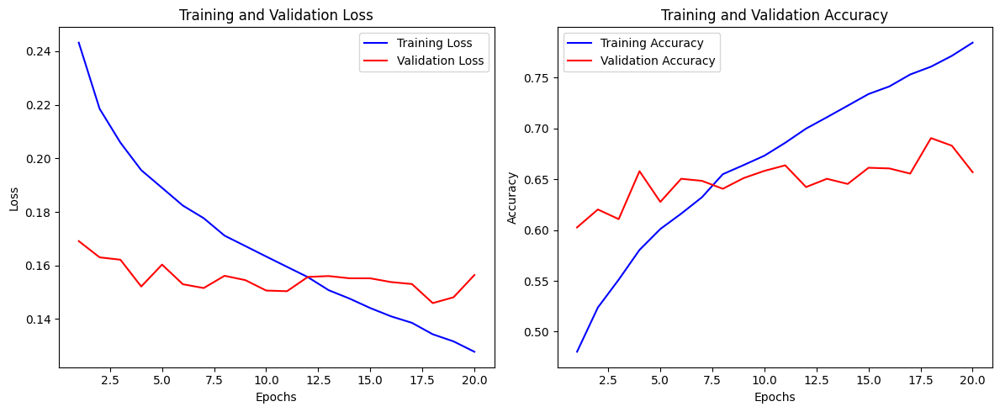

In [ ]:
# Assuming 'history' is the returned object from model_mobilenet.fit
history_dict = fine_tune_history.history

# Extract loss and accuracy for both training and validation
train_loss = history_dict['loss']
val_loss = history_dict['val_loss']
train_accuracy = history_dict['accuracy']
val_accuracy = history_dict['val_accuracy']

# Create a figure with two subplots: one for loss and one for accuracy
epochs = range(1, len(train_loss) + 1)

plt.figure(figsize=(12, 5))

# Plot the loss values
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'r', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plot the accuracy values
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy, 'b', label='Training Accuracy')
plt.plot(epochs, val_accuracy, 'r', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
# Evaluate the model on the test data
test_loss, test_acc, test_recall = inception_resnet_v2_model.evaluate(test_generator)
print(f"Test Accuracy: {test_acc * 100:.2f}%")
print(f"Test Recall: {test_recall * 100:.2f}%")
print(f"Test Loss: {test_loss:.4f}")

48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 96ms/step - accuracy: 0.5804 - loss: 0.1856 - recall: 0.3111
Test Accuracy: 69.50%
Test Recall: 45.14%
Test Loss: 0.1451


### Saving Model

In [ ]:
# Define the path where you want to save your model in Google Drive
save_path = '/content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass'

# Create the directory if it doesn't exist
os.makedirs(save_path, exist_ok=True)

# Save your inception_resnet_v2_model in .keras format
model_save_path = os.path.join(save_path, "inception_resnet_v2_model_recall.keras")
inception_resnet_v2_model.save(model_save_path)

print(f"Model saved to: {model_save_path}")

Model saved to: /content/drive/MyDrive/MIDS 210A - Capstone Project/Code/Modeling/Models/FourClass/inception_resnet_v2_model_recall.keras


### Loading Model

In [ ]:
# Define the path to your saved InceptionResNetV2 model
model_path = model_save_path

# Load the model with custom objects
model = tf.keras.models.load_model(model_path)

# Display the model summary to verify it loaded correctly
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 111, 111, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 111, 111, 32)   │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, 111, 111, 32)   │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 109, 109, 32)   │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 109, 109, 32)   │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, 109, 109, 32)   │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 109, 109, 64)   │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 109, 109, 64)   │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, 109, 109, 64)   │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, 54, 54, 64)     │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 54, 54, 80)     │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 54, 54, 80)     │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, 54, 54, 80)     │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 52, 52, 192)    │        138,240 │ activation_3[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 52, 52, 192)    │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_4 (Activat

 Total params: 63,213,678 (241.14 MB)

 Trainable params: 4,333,860 (16.53 MB)

 Non-trainable params: 50,212,096 (191.54 MB)

 Optimizer params: 8,667,722 (33.06 MB)

### Evaluating Model

#### Printing Metrics

In [ ]:
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions, axis=1)  # Get the predicted class indices
y_true = test_generator.classes  # True labels from the generator

48/48 ━━━━━━━━━━━━━━━━━━━━ 26s 316ms/step


In [ ]:
print(f"Precision: {precision_score(y_true, y_pred, average='weighted')}")
print(f"Recall: {recall_score(y_true, y_pred, average='weighted')}")
print(f"F1 Score: {f1_score(y_true, y_pred, average='weighted')}")
print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
# print(f"AUC: {roc_auc_score(y_true, y_pred)}")

Precision: 0.7126114053526444
Recall: 0.69498838367076
F1 Score: 0.6984778261494822
Accuracy: 0.69498838367076


#### Displaying Confusion Matrix

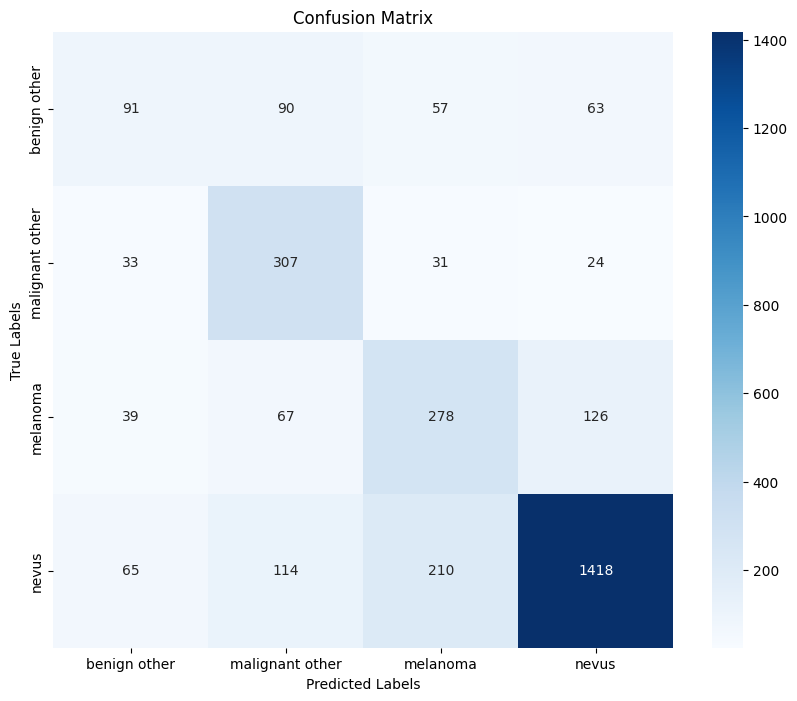

In [ ]:
# Get the class names from the test generator (adjust this based on your test generator)
class_names = list(test_generator.class_indices.keys())

# Generate the confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues",
            xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()